<a href="https://colab.research.google.com/github/Ayrsz/SignalAndSistemyProject/blob/main/Augmentation_Audios.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Scientific computation

import numpy as np
import jax
import jax.numpy as jnp

# Plot and view
from matplotlib import pyplot as plt
import IPython as ipy
from IPython import display
from IPython.display import Audio

# Data manipulation
import scipy as sci
import os

# Audio manipulation
import librosa
import soundfile as sf

# Building files

In [2]:
from zipfile import ZipFile

try:
    from google.colab import drive

    drive.mount("/content/drive", force_remount=True)
except Exception as e:
    print(e)
    print("Rodando localmente")

No module named 'google.colab'
Rodando localmente


In [4]:
# Unzip in a specific folder
path_root = "/home/mas11/Documents/Datasets"
path_zip = path_root + "/GTZAN.zip"
with ZipFile(path_zip, "r") as zip_archive:
    if not os.path.exists(path_root + "/Data"):
        print(f"Unzipando em : {path_root}")
        zip_archive.extractall(path_root)
        print("Unzipado!")
    else:
        print("Arquivo já unzipado, sem necessidade de ações.")

Arquivo já unzipado, sem necessidade de ações.


## Auxiliar functions of dirs

In [5]:
def dir_genres(path_all_genres: str):
    return [path_all_genres + "/" + pasta for pasta in os.listdir(path_all_genres)]


# Return all files.wav separated per genres
def dir_files_wav(path_genre: str):
    return [path_genre + "/" + arquivo for arquivo in os.listdir(path_genre)]


# Audio augmentation

## Plot functions

In [6]:
def plt_audios(sample_rate, names, audios):
 
    
    n = len(audios)
    assert n > 0

    fig, axes = plt.subplots(n, 1, figsize=(10, 2 * n), sharex=True)

    try:
        amp_max = np.max(audios)
    except:
        amp_max = np.max(audios[0])
    y_lim = (-1*amp_max, amp_max)
   
    if n == 1:
        axes = [axes]  
    
    for i, audio in enumerate(audios):
        t = np.linspace(0, len(audio) / sample_rate, num=len(audio))
        axes[i].plot(t, audio, label=names[i])
        axes[i].legend( loc = "lower center")
        axes[i].set_ylabel("Amplitude")
        plt.ylim(y_lim)
        
        

    axes[-1].set_xlabel("Tempo (s)")
    plt.tight_layout()
    plt.show()


## Effects

In [11]:
audio, sample_rate = librosa.load(
    "/home/mas11/Downloads" + "/musica_shrek.wav"
)
Audio(audio, rate = sample_rate)

### Trim

In [8]:
### Siencia
def add_trim(audio):
    silenced, _ = librosa.effects.trim(audio)

    return silenced



display.display("Audio original")
display.display(Audio(audio, rate=sample_rate))

noise = add_trim(audio)
display.display("Audio com ruido")
display.display(Audio(noise, rate = sample_rate))

'Audio original'

'Audio com ruido'

In [9]:
plt_audios(sample_rate, ["original", "noised", "dif"], [audio, noise, (audio-noise)])


ValueError: operands could not be broadcast together with shapes (661500,) (653308,) 

### Percursive Atenuation

In [10]:
def add_percursive(audio):
    return librosa.effects.percussive(audio, power = 1)

percusivo = add_percursive(audio)
display.display("Audio original")
display.display(Audio(audio, rate=sample_rate))

noise = add_percursive(audio)
display.display("Audio com ruido")
display.display(Audio(percusivo, rate = sample_rate))

'Audio original'

'Audio com ruido'

### Gaussian Noise

In [14]:
def add_gaussian_noise(audio, intensity = None):
    if intensity is None:
        intensity = np.random.uniform(0.003, 0.015 )
    noise = np.random.normal(0, 1, size=(len(audio)))

    return audio + noise * intensity

In [16]:
display.display("Audio original")
display.display(Audio(audio, rate=sample_rate))

noise = add_gaussian_noise(audio, 0.015)
display.display("Audio com ruido")
display.display(Audio(noise, rate = sample_rate))

sf.write("/home/mas11/Downloads/noised_shrek.wav", noise, samplerate = sample_rate)

'Audio original'

'Audio com ruido'

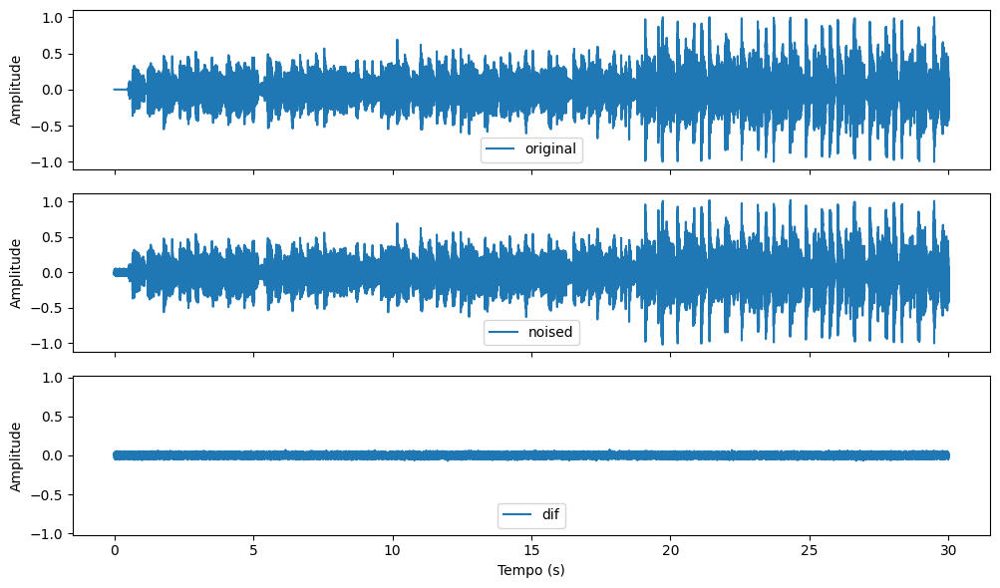

In [17]:
plt_audios(sample_rate, ["original", "noised", "dif"], [audio, noise, (audio-noise)])

In [ ]:
#plt_spectogram(jax.numpy.array([audio, noise]), sample_rate = sample_rate)

### Echo


In [ ]:
def add_echo(audio, sample_rate, delay = None, intensity = None):
    assert (delay is None and intensity is None) or (delay is not None and intensity is not None)
    if(delay is None and intensity is None):
        delay = np.random.uniform(0.5, 1)
        intensity = np.random.uniform(-1.5, 1.5)

    delay_samples = int(delay * sample_rate)

    echo = np.zeros(len(audio) + delay_samples)
    
    echo[:len(audio)] = audio

    echo[delay_samples:] += intensity * audio

    echo = echo[ : len(audio)]
    return echo
    
#echoed = add_echo(audio, 3, 0.5)

display.display("Audio original")
display.display(Audio(audio, rate=sample_rate))

echoed = add_echo(audio, sample_rate)
display.display("Audio com eco")
display.display(Audio(echoed, rate = sample_rate))


'Audio original'

'Audio com eco'

In [36]:
plt_audios(sample_rate, ["Original", "Echoed", "Dif"], [audio, echoed, audio - echoed])

NameError: name 'plt_audios' is not defined

### Gain

In [32]:
def add_gain(audio, gain = None):
    if gain is None:
        gain = np.random.uniform(-3, 3)

    return audio + audio*gain

display.display("Audio original")
display.display(Audio(audio, rate=sample_rate))

gained = add_gain(audio, 5)
display.display("Audio com ganho")
display.display(Audio(echoed, rate = sample_rate))
    

'Audio original'

'Audio com ganho'

NameError: name 'echoed' is not defined

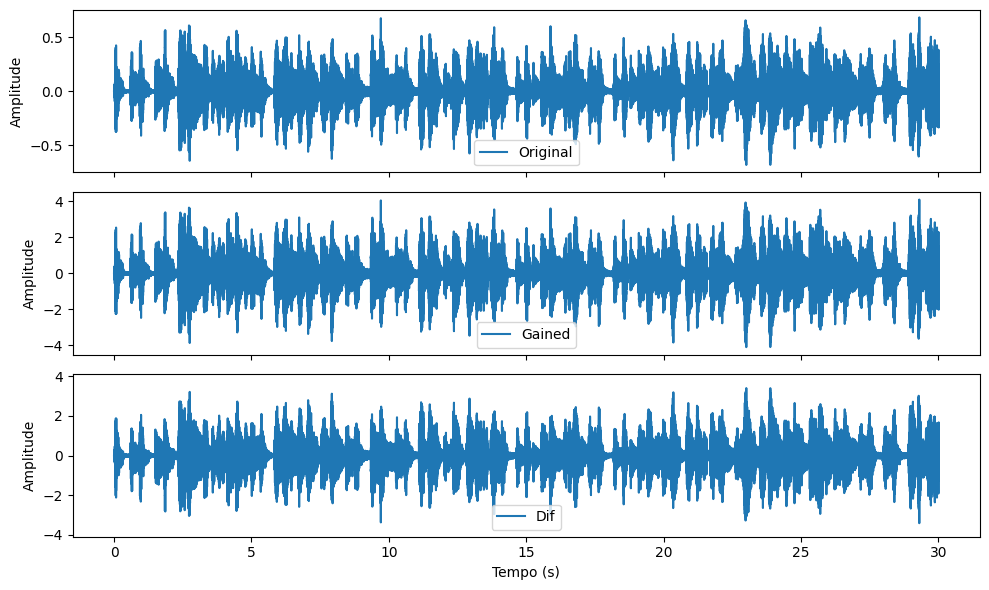

In [ ]:
plt_audios(sample_rate, ["Original", "Gained", "Dif"], [audio, gained, audio - gained])

### Emphase

In [33]:
def add_emphase(audio, coef = None):
    if coef is None:
        coef = np.random.uniform(0.5, 2)
    
    return librosa.effects.preemphasis(y = audio, coef = coef)


emphased = add_emphase(audio, 1.5)   


display.display("Audio original")
display.display(Audio(audio, rate=sample_rate))

display.display("Audio com enfase")
display.display(Audio(emphased, rate = sample_rate))


'Audio original'

'Audio com enfase'

In [34]:
plt_audios(sample_rate, ["Original", "Enfase", "Dif"], [audio, emphased, audio-emphased])

NameError: name 'plt_audios' is not defined

### Pitch Shift


In [46]:
def add_pitch_shift(audio, sample_rate, num_escala = None):
    
    if(num_escala is None):
        num_escala = np.random.randint(-3, 3)

    return librosa.effects.pitch_shift(y = audio, sr=sample_rate, n_steps= num_escala)

shifted = add_pitch_shift(audio, sample_rate, 3)   


display.display("Audio original")
display.display(Audio(audio, rate=sample_rate))

display.display("Audio com enfase")
display.display(Audio(emphased, rate = sample_rate))

'Audio original'

'Audio com enfase'

In [47]:
plt_audios(sample_rate, ["Original", "Pitch-Shift", "Dif"], [audio, shifted, audio-shifted])

NameError: name 'plt_audios' is not defined

### Speed Up

In [19]:
def speed_up(audio, speed_rate = None):
    if speed_rate is None:
        speed_rate = np.random.uniform(0.75, 1.25)

    return librosa.effects.time_stretch(audio, rate = speed_rate)

speeded = speed_up(audio, 1.25)
display.display(Audio(speeded, rate = sample_rate))
sf.write("/home/mas11/Downloads/speed_shrek.wav", speeded, samplerate = sample_rate)      

In [30]:
plt_audios(sample_rate, ["Original", "speeded"], [audio, speeded])

NameError: name 'plt_audios' is not defined

## Apply distortion Set and Write

In [62]:
def apply_effects(audio, sample_rate):
    transformation_set = {
        0: lambda sig: add_echo(sig, sample_rate),
        1: add_emphase,
        2: lambda sig: add_pitch_shift(sig, sample_rate),
        3: speed_up,
        4: add_gain,
        5: add_gaussian_noise,
        6: add_percursive,
        7: add_trim,
    }

    transformation_set_info = {
        0: "_echo",
        1: "_emphased",
        2: "__pitchshift",
        3: "_speedup",
        4: "_gain",
        5: "_noise",
        6: "_percusive",
        7: "_trim",
    }
    number_of_compositions = 5
    new_audios = []
    distortions_names = []

    for i in range(number_of_compositions):
        new_audio = audio

        # Aplica 2 filtros DIFERENTES
        distortions_choices = np.random.choice(8, size=2, replace=False)
        distortions_applied_to_this_audio = [
            transformation_set_info[i] for i in distortions_choices
        ]

        for dist in distortions_choices:
            new_audio = transformation_set[dist](new_audio)

        new_audios.append(new_audio)
        distortions_names.append(distortions_applied_to_this_audio)

    return new_audios, distortions_names


def write_audios(
    audios, path, genre, idx, sample_rate, distortions_applied : list, num_original
):
    for i, audio in enumerate(audios):
        nome_distorcoes = "".join(distortions_applied[i])

        idx_string = f"{idx:05d}"  # String format
        new_file = (
            path
            + "/"
            + genre
            + (nome_distorcoes)
            + "_orig"
            + num_original
            + "."
            + idx_string
            + ".wav"
        )
        idx = idx + 1
        sf.write(new_file, audio, sample_rate)

    return idx


# Writing new audios
def write_new_files_wav(path_genre: str):
    genre = path_genre.split("/")[-1]
    print(f"Audiomentations on {genre}")
    files_from_path = dir_files_wav(path_genre)
    file_index_integer = len(files_from_path)
    if file_index_integer >= 101:
        print(f"Algoritmo já executado para esta pasta: {genre}")
    else:
        for file_wav in files_from_path:
            try:
                audio, sample_rate = librosa.load(file_wav)
                new_audios, distortions_applied = apply_effects(audio, sample_rate)

                num_audio_original = ((file_wav.split("/")[-1]).split("."))[1]
                
                file_index_integer = write_audios(
                    new_audios,
                    path_genre,
                    genre,
                    file_index_integer,
                    sample_rate,
                    distortions_applied,
                    num_original=num_audio_original,
                )
                
            except Exception as e:
                print(e)
                print(f"Arquivo com problema! {file_wav.split('/')[-1]}")


def augmentation(path_root):
    path_from_each_genre = dir_genres(path_root)
    for path_genre in path_from_each_genre:
        write_new_files_wav(path_genre)
        


augmentation(path_root + "/Data/genres_original")

Audiomentations on classical
Audiomentations on country
Audiomentations on metal
Audiomentations on jazz


/tmp/ipykernel_6003/1332150485.py:80: UserWarning: PySoundFile failed. Trying audioread instead.
  audio, sample_rate = librosa.load(file_wav)
/home/mas11/.local/lib/python3.10/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)



Arquivo com problema! jazz.00054.wav
Audiomentations on hiphop
Audiomentations on blues
Audiomentations on rock
Audiomentations on pop
Audiomentations on reggae
Audiomentations on disco
